In [2]:
# import numpy as np

# # !/usr/bin/env python3
# # -*- coding: utf-8 -*-
# """
# Created on 20181219

# @author: zhangji

# Trajection of a ellipse, Jeffery equation. 
# """

# %pylab inline
# pylab.rcParams['figure.figsize'] = (25, 11)
# fontsize = 40

# import numpy as np
# import scipy as sp
# from scipy.optimize import leastsq, curve_fit
# from scipy import interpolate
# from scipy.interpolate import interp1d
# from scipy.io import loadmat, savemat
# # import scipy.misc

# import matplotlib
# from matplotlib import pyplot as plt
# from matplotlib import animation, rc
# import matplotlib.ticker as mtick
# from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
# from mpl_toolkits.mplot3d import Axes3D, axes3d

# from sympy import symbols, simplify, series, exp
# from sympy.matrices import Matrix
# from sympy.solvers import solve

# from IPython.display import display, HTML
# from tqdm import tqdm_notebook as tqdm
# import pandas as pd
# import re
# from scanf import scanf
# import os
# import glob

# from codeStore import support_fun as spf
# from src.support_class import *
# from src import stokes_flow as sf

# rc('animation', html='html5')
# PWD = os.getcwd()
# font = {'size': 20}
# matplotlib.rc('font', **font)
# np.set_printoptions(linewidth=90, precision=5)

%load_ext autoreload
%autoreload 2

from tqdm import tqdm_notebook
import os
import glob
import natsort 
import numpy as np
import scipy as sp
from scipy.optimize import leastsq, curve_fit
from scipy import interpolate, integrate
from scipy import spatial, signal
# from scipy.interpolate import interp1d
from scipy.io import loadmat, savemat
# import scipy.misc
from IPython.display import display, HTML
import pandas as pd
import pickle
import re
from scanf import scanf
from datetime import datetime

import matplotlib
# matplotlib.use('agg')
from matplotlib import pyplot as plt
import matplotlib.colors as colors
from matplotlib import animation, rc
import matplotlib.ticker as mtick
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
from mpl_toolkits.mplot3d import Axes3D, axes3d
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from mpl_toolkits.mplot3d.art3d import Line3DCollection
from matplotlib import cm

from tqdm.notebook import tqdm as tqdm_notebook
from tqdm import tqdm
from time import time
from src.support_class import *
from src import jeffery_model as jm
from codeStore import support_fun as spf
from codeStore import support_fun_table as spf_tb

# %matplotlib notebook
%matplotlib inline
rc('animation', html='html5')
fontsize = 40
PWD = os.getcwd()

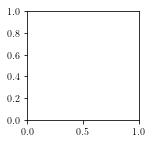

In [3]:
fig = plt.figure(figsize=(2, 2))
fig.patch.set_facecolor('white')
ax0 = fig.add_subplot(1, 1, 1)

In [4]:
# job_dir = 'ecoC01B05_passive_psi-0a'
job_dir = 'ecoC01B05_passive_psi_rada'

t_headle = '(.*?).pickle'

In [5]:
n_load = 10000
rand_mode=False

t_dir = os.path.join(PWD, job_dir)
# _ = spf_tb.load_rand_data_pickle_dir_v2(t_dir, t_headle, n_load=n_load, rand_mode=rand_mode)
t_name = os.path.join(os.getcwd(), 'ecoC01B05_phase_Peclet', '%s.pickle' % job_dir)
with open(t_name, 'rb') as myinput:
    _ = pickle.load(myinput)
ini_theta_list, ini_phi_list, ini_psi_list, std_eta_list, psi_max_phi_list, \
theta_autocorrelate_fre_list, phi_autocorrelate_fre_list, psi_autocorrelate_fre_list, \
eta_autocorrelate_fre_list, dx_list, dy_list, dz_list, pickle_path_list = _

In [8]:
np.sum(dy_list < 0)

176

In [5]:
t_name = os.path.join(os.getcwd(), 'ecoC01B05_phase_Peclet', '%s.pickle' % job_dir)
with open(t_name, 'wb') as handle:    
    pickle.dump(_, handle, protocol=pickle.HIGHEST_PROTOCOL)
print('save to %s' % t_name)

save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_phase_Peclet/ecoC01B05_passive_psi_rada.pickle


In [6]:
n_load = 10000
rand_mode=False

t_dir = os.path.join(PWD, job_dir)
_ = spf_tb.load_rand_data_pickle_dir_instant(t_dir, t_headle, n_load=n_load, rand_mode=rand_mode, 
                                             t_step=10)
pickle_path_list_instant, idx_list, intp_t, intp_X_list = _

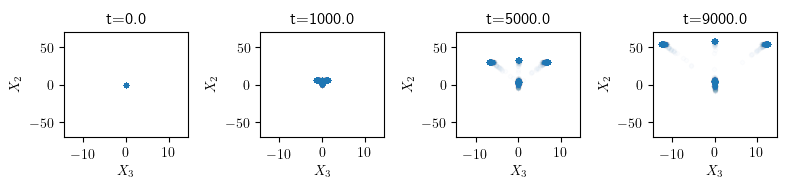

In [7]:
figsize = np.array((8, 2)) * 1
dpi = 100
use_Tidx_list = [0, 100, 500, 900]
# x_lim = [intp_X_list[:, 2, :].min(), intp_X_list[:, 2, :].max()]
# y_lim = [intp_X_list[:, 1, :].min(), intp_X_list[:, 1, :].max()]
x_lim = [-14.5, 14.5]
y_lim = [-70, 70]

# fig, axi = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
# fig.patch.set_facecolor('white')
# for intp_X in intp_X_list:
#     axi.plot(intp_t, intp_X[:, 1])

fig_nrow = 1
fig_ncol = int(np.ceil(len(use_Tidx_list) / fig_nrow))
fig, axs = plt.subplots(fig_nrow, fig_ncol, figsize=figsize, dpi=dpi)
fig.patch.set_facecolor('white')
for axi, use_Tidx in zip(axs.ravel(), use_Tidx_list):
    tx = intp_X_list[use_Tidx, 2, :]
    ty = intp_X_list[use_Tidx, 1, :]
    axi.plot(tx, ty, '.', alpha=0.01)
    axi.set_title('t=%.1f' % intp_t[use_Tidx])
    axi.set_xlim(*x_lim)
    axi.set_ylim(*y_lim)
    axi.set_xlabel('$X_3$')
    axi.set_ylabel('$X_2$')

plt.tight_layout()

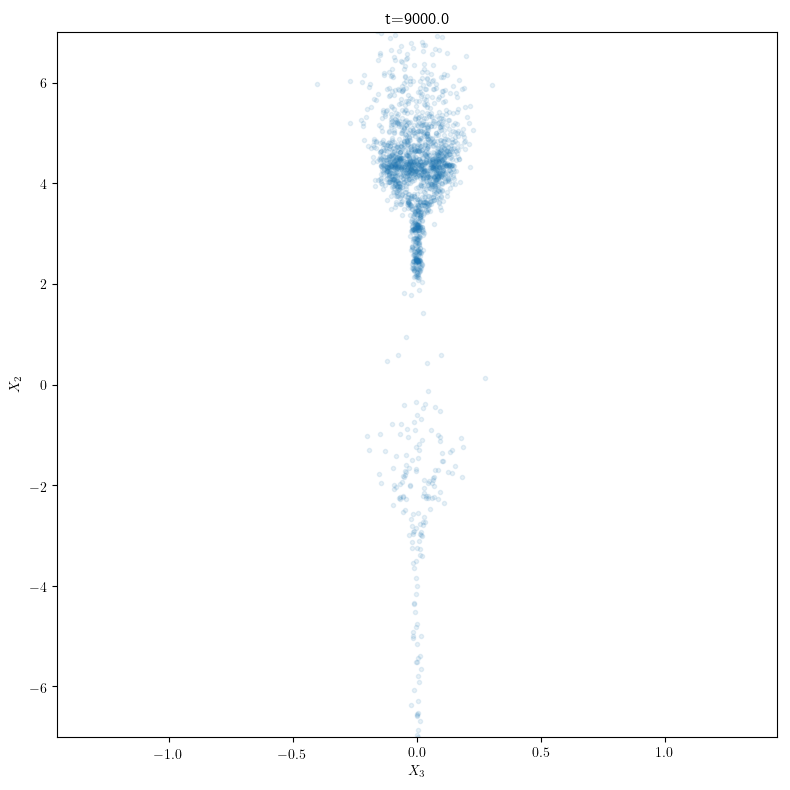

In [8]:
figsize = np.array((8, 8)) * 1
dpi = 100
use_Tidx = 900
# x_lim = [intp_X_list[:, 2, :].min(), intp_X_list[:, 2, :].max()]
# y_lim = [intp_X_list[:, 1, :].min(), intp_X_list[:, 1, :].max()]
x_lim = [-1.45, 1.45]
y_lim = [-7.0, 7.0]

# fig, axi = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
# fig.patch.set_facecolor('white')
# for i0 in range(intp_X_list.shape[-1]):
#     intp_X = intp_X_list[..., i0]
#     axi.plot(intp_t, intp_X[:, 1])

fig, axi = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
fig.patch.set_facecolor('white')
tx = intp_X_list[use_Tidx, 2, :]
ty = intp_X_list[use_Tidx, 1, :]
axi.plot(tx, ty, '.', alpha=0.1)
axi.set_title('t=%.1f' % intp_t[use_Tidx])
axi.set_xlim(*x_lim)
axi.set_ylim(*y_lim)
axi.set_xlabel('$X_3$')
axi.set_ylabel('$X_2$')

plt.tight_layout()

[[   0    1    2    3    4    5    6    7]
 [   1 2401  205 5496    5 1890    1    1]]


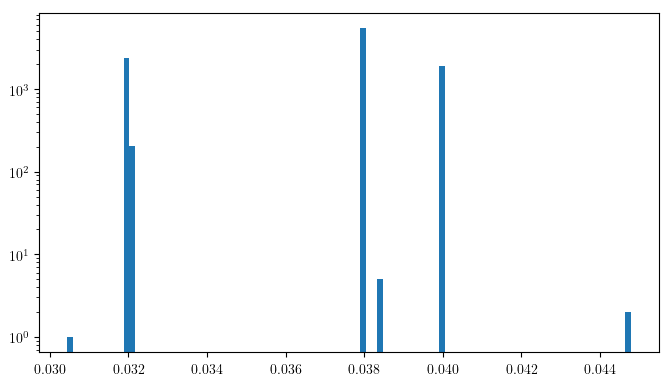

In [9]:
n_hist = 100
figsize = np.array((16, 9)) * 0.5
dpi = 100
# use_autocorrelate_fre_list =theta_autocorrelate_fre_list
use_autocorrelate_fre_list = eta_autocorrelate_fre_list

tmax_fre_list = np.hstack([t1[0, 0] for t1 in use_autocorrelate_fre_list])
# tmax_fre_list = tmax_fre_list[tmax_fre_list < 0.04]
fig, axi = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
t1 = axi.hist(tmax_fre_list, n_hist)
axi.set_yscale('log')

bin_edges = np.histogram_bin_edges(tmax_fre_list, n_hist)
case_idx0 = np.digitize(tmax_fre_list, bin_edges)
case_idx = np.ones_like(case_idx0) * -1
for i1, i0 in enumerate(np.unique(case_idx0)):
    tidx = np.isclose(case_idx0, i0)
    case_idx[tidx] = i1
assert np.all(case_idx >= 0)
print(np.vstack((np.unique(case_idx), np.bincount(case_idx))))

/anaconda3/envs/py35/lib/python3.5/site-packages/matplotlib/tight_layout.py:199: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  warnings.warn('Tight layout not applied. '


True

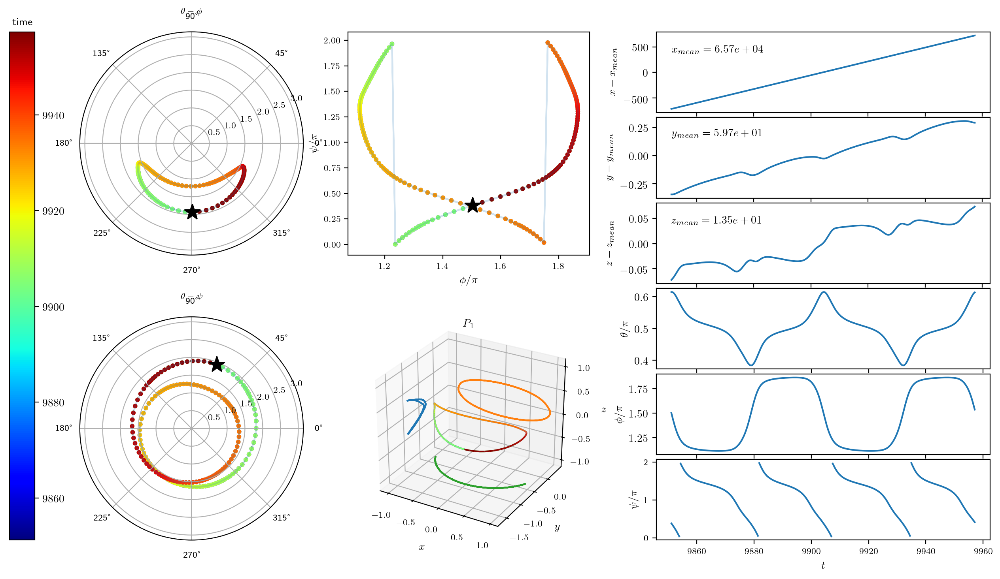

In [7]:
tidx = np.isclose(case_idx, 3)
tpath = pickle_path_list[tidx][100]
show_colorbar = False 
figsize=np.array((16, 9)) * 1
dpi=200

with open(tpath, 'rb') as handle:
    tpick = pickle.load(handle)
Table_t = tpick['Table_t']
Table_dt = tpick['Table_dt']
Table_X = tpick['Table_X']
Table_P = tpick['Table_P']
Table_P2 = tpick['Table_P2']
Table_theta = tpick['Table_theta']
Table_phi = tpick['Table_phi']
Table_psi = tpick['Table_psi']
Table_eta = tpick['Table_eta']
idx = (Table_t > 9851) * (Table_t < 9957.5)
spf_tb.show_table_result_v2(Table_t[idx], Table_dt[idx], Table_X[idx], Table_P[idx], Table_P2[idx], 
                            Table_theta[idx], Table_phi[idx], Table_psi[idx], Table_eta[idx], 
                            figsize=figsize, dpi=dpi)

# idx = Table_t > 9000
# fig = plt.figure(figsize=(5, 5), dpi=300)
# spf_tb.light_show_theta_phi(Table_t[idx], Table_dt[idx], Table_X[idx], Table_P[idx], Table_P2[idx], 
#                             Table_theta[idx], Table_phi[idx], Table_psi[idx], Table_eta[idx], 
#                             fig=fig, show_colorbar=show_colorbar)

In [11]:
idx = np.logical_and(Table_t > 9940, Table_t < 9980)
print(Table_t[idx][np.argmax(Table_theta[idx])], Table_t[idx][np.argmax(Table_theta[idx])+1])
idx = np.logical_and(Table_t > 9840, Table_t < 9900)
print(Table_t[idx][np.argmax(Table_theta[idx])], Table_t[idx][np.argmax(Table_theta[idx])-1])

9957.354660739169 9957.634575905458
9851.190633279966 9850.900120871385


In [12]:
use_case = 5
for use_case, n_case in zip(np.unique(case_idx), np.bincount(case_idx)):
    tidx = np.isclose(case_idx, use_case)
    # np.mean(psi_max_phi_list[tidx][psi_max_phi_list[tidx] > np.pi])
    print(use_case, n_case, np.mean(std_eta_list[tidx][:, 0] / np.pi), (std_eta_list[tidx][:, 1] / np.pi).max())

0 1 0.47817818808127033 0.02161456936760251
1 2401 0.4781521417397699 0.021984829246457144
2 205 0.4783579579197221 0.021915979804066107
3 5496 0.7021196159436214 0.0787475848877678
4 5 0.20592151967085628 0.005813715164536105
5 1890 0.8980694188356446 0.04683083653087409
6 1 0.0072121727177572575 0.004160843982784411
7 1 0.003862517668861055 0.001796772682026291


(array([0., 0., 0., 0., 0., 1., 0., 0., 0., 0.]),
 array([-0.49613748, -0.39613748, -0.29613748, -0.19613748, -0.09613748,
         0.00386252,  0.10386252,  0.20386252,  0.30386252,  0.40386252,
         0.50386252]),
 <a list of 10 Patch objects>)

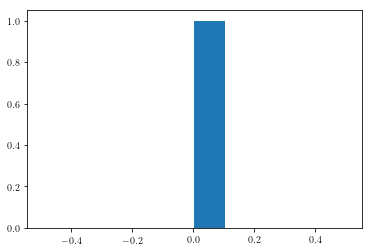

In [13]:
plt.hist(std_eta_list[tidx][:, 0] / np.pi)

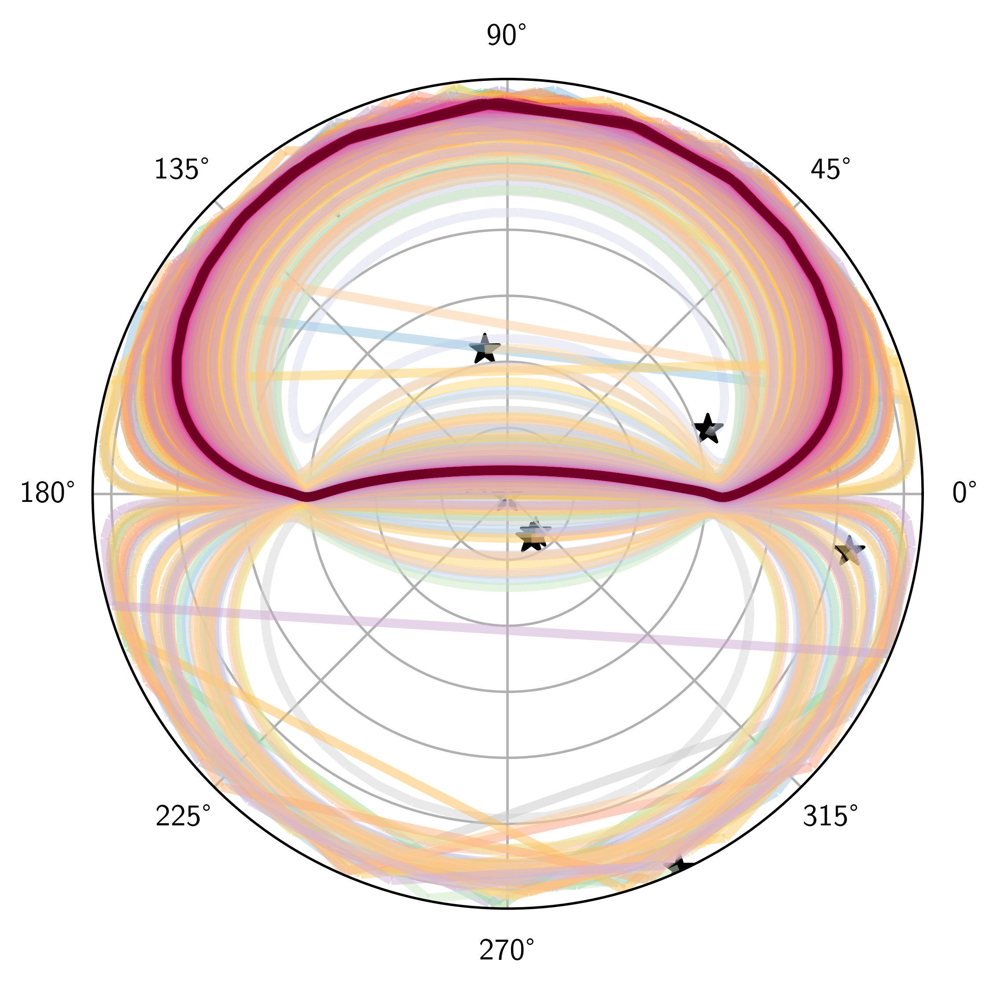

In [25]:
figsize=np.array((5, 5))
dpi=500

tidx = np.logical_or(np.logical_or(np.isclose(case_idx, 0), np.isclose(case_idx, 1)), np.isclose(case_idx, 2))

# tidx = np.isclose(case_idx, 3)

# tidx = np.logical_and(np.isclose(case_idx, 5), dy_list > 0)

# tidx = np.logical_and(np.isclose(case_idx, 5), dy_list < 0)

sub_idx = np.random.choice(np.sum(tidx), 10, replace=False)
fig = spf_tb.show_pickle_theta_phi_list(pickle_path_list[tidx][sub_idx], figsize=figsize, dpi=dpi, 
                                        fast_mode=0, markersize=100, linewidth=3, 
                                        Table_t_range=(0, 3000))
# fig = spf_tb.show_pickle_theta_phi_list(pickle_path_list[tidx][sub_idx], figsize=figsize, dpi=dpi, 
#                                       fast_mode=1, markersize=100, Table_t_range=(0, 3000))

In [55]:
sub_idx = np.random.choice(np.sum(tidx), 5, replace=False)
sub_idx
# tidx

array([141, 112,  51, 156, 139])

(array([   0.,    0.,    0.,    0.,    0., 2607.,    0.,    0.,    0.,
          0.]), array([0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3, 1.4, 1.5]), <a list of 10 Patch objects>)
0
2607, 0.0065, 0.0065, 0.0065, 5.99e-07
0.4781683359719262 0.021984829246457144


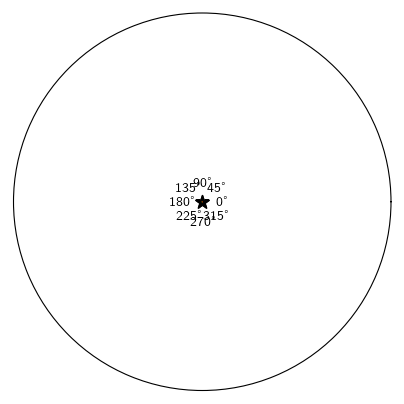

In [34]:
tidx = np.logical_or(np.logical_or(np.isclose(case_idx, 0), np.isclose(case_idx, 1)), np.isclose(case_idx, 2))
use_autocorrelate_fre_list = eta_autocorrelate_fre_list

# tidx = np.isclose(case_idx, 3)
# use_autocorrelate_fre_list = eta_autocorrelate_fre_list

# tidx = np.logical_and(np.isclose(case_idx, 5), dy_list > 0)
# use_autocorrelate_fre_list = psi_autocorrelate_fre_list

# tidx = np.logical_and(np.isclose(case_idx, 5), dy_list < 0)
# use_autocorrelate_fre_list = psi_autocorrelate_fre_list

t1 = use_autocorrelate_fre_list[tidx][:, 0]
t2 = use_autocorrelate_fre_list[tidx][:, 1][t1[:, 0] / t1[:, 1] > 1]
print(plt.hist(t1[:, 0] / t1[:, 1], log=True))
if t2.size > 0:
    print((t2[:, 1] / t2[:, 0]).max())
else:
    print(0)
print('%d, %.4f, %.4f, %.4f, %.2e' % (tidx.sum(), dy_list[tidx].max(), dy_list[tidx].min(), 
                                      dy_list[tidx].mean(), dy_list[tidx].std()))
print(np.mean(std_eta_list[tidx][:, 0] / np.pi), (std_eta_list[tidx][:, 1] / np.pi).max())

(array([  10.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1880.]),
 array([0.01511773, 0.11007511, 0.20503249, 0.29998986, 0.39494724,
        0.48990462, 0.584862  , 0.67981938, 0.77477676, 0.86973414,
        0.96469152]),
 <a list of 10 Patch objects>)

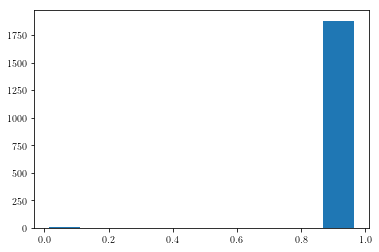

In [48]:
use_case = 5
tidx = np.isclose(case_idx, use_case)
plt.hist(std_eta_list[tidx][:, 0] / np.pi)

In [144]:
tname = '%s_%s_%02d' % (job_dir, suptitle_handle, i0)
tname

'ecoC01B05_passive_psi_rada_d_00'

In [148]:
tname

'/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_d_00.pickle'

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.512_ph2.755_ps6.052_D20200423_T043000.pickle
trange_geo= 1.4044721897726693


2020-07-27 15:10:13.166385 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c1_00.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.601_ph1.295_ps5.176_D20200423_T042532.pickle
trange_geo= 1.284085611730626


2020-07-27 16:10:25.055147 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c2_00.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.512_ph3.298_ps4.196_D20200423_T060935.pickle
trange_geo= 1.100843531653635


2020-07-27 16:47:58.728131 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c3_00.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.837_ph6.260_ps1.820_D20200423_T030949.pickle
trange_geo= 1.4090639811298968


2020-07-27 17:19:30.820382 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c4_00.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.018_ph1.881_ps5.483_D20200423_T054541.pickle
trange_geo= 1.362995043119577


2020-07-27 18:20:17.281102 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c1_01.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.441_ph4.516_ps3.668_D20200429_T134327.pickle
trange_geo= 1.235475210314129


2020-07-27 19:22:16.300509 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c2_01.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.624_ph1.960_ps3.849_D20200430_T110755.pickle
trange_geo= 1.3625580181600974


2020-07-27 20:00:02.610567 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c3_01.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.952_ph4.106_ps4.370_D20200423_T032303.pickle
trange_geo= 1.4103529643520618


2020-07-27 20:29:59.019390 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c4_01.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.413_ph3.832_ps5.667_D20200423_T043818.pickle
trange_geo= 1.3971944539036647


2020-07-27 21:32:09.089807 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c1_02.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.522_ph4.133_ps3.539_D20200429_T213240.pickle
trange_geo= 1.3965790059344427


2020-07-27 22:34:38.755029 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c2_02.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.782_ph4.733_ps1.249_D20200423_T043058.pickle
trange_geo= 1.3325014803736281


2020-07-27 23:11:53.759301 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c3_02.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.761_ph0.096_ps2.309_D20200429_T220405.pickle
trange_geo= 1.4075634521802531


2020-07-27 23:40:50.497614 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c4_02.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.551_ph4.442_ps0.910_D20200423_T060513.pickle
trange_geo= 1.3830383949924983


2020-07-28 00:44:53.939588 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c1_03.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th1.638_ph4.251_ps4.684_D20200429_T175609.pickle
trange_geo= 1.3469585193158038


2020-07-28 01:45:52.725475 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c2_03.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.194_ph1.961_ps2.117_D20200423_T053543.pickle
trange_geo= 1.3084683974211364


2020-07-28 02:24:14.403285 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c3_03.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th0.043_ph1.614_ps0.201_D20200423_T061018.pickle
trange_geo= 1.4019020743581327


2020-07-28 02:54:25.089122 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c4_03.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th2.267_ph4.907_ps5.133_D20200430_T143045.pickle
trange_geo= 1.4166862217513485


2020-07-28 03:58:24.355639 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c1_04.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th2.693_ph0.371_ps0.860_D20200423_T045947.pickle
trange_geo= 1.3833247541245777


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-07-28 05:37:00.030230 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c3_04.mp4

/home/zhangji/stokes_flow_master/head_Force/do_calculate_table/ecoC01B05_passive_psi_rada/th2.662_ph0.760_ps3.935_D20200430_T185352.pickle
trange_geo= 1.409857837536598


2020-07-28 06:04:26.588891 save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/MOVIE/ecoC01B05_passive_psi_rada_c4_04.mp4



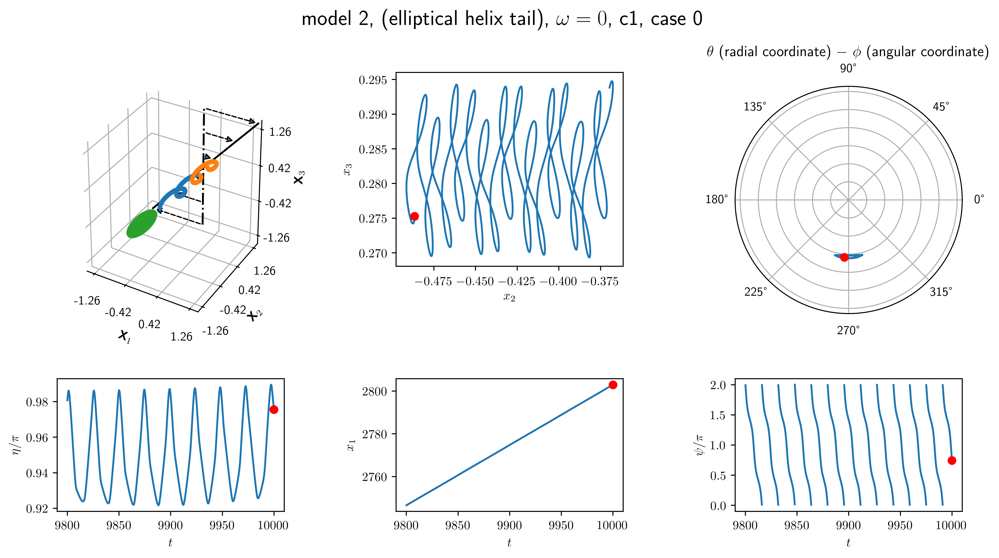

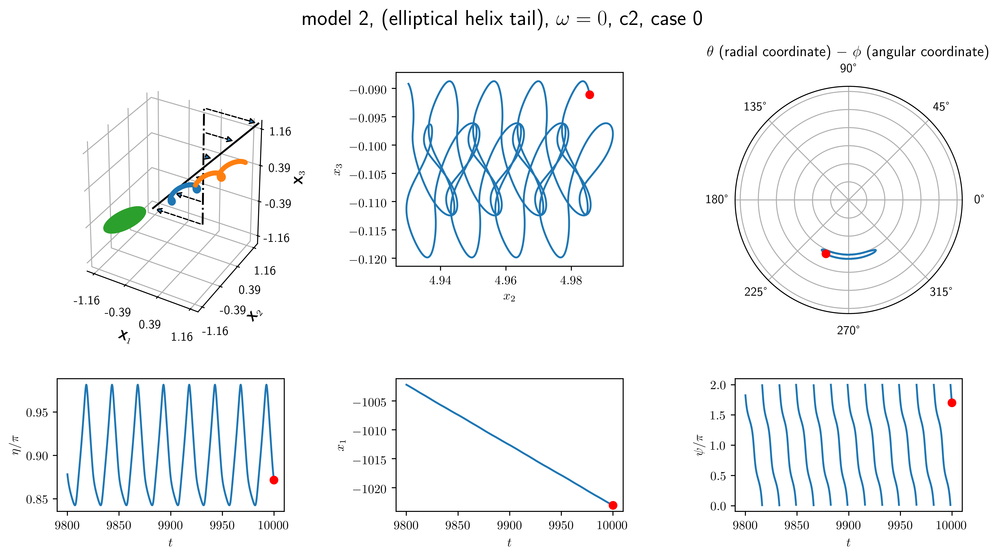

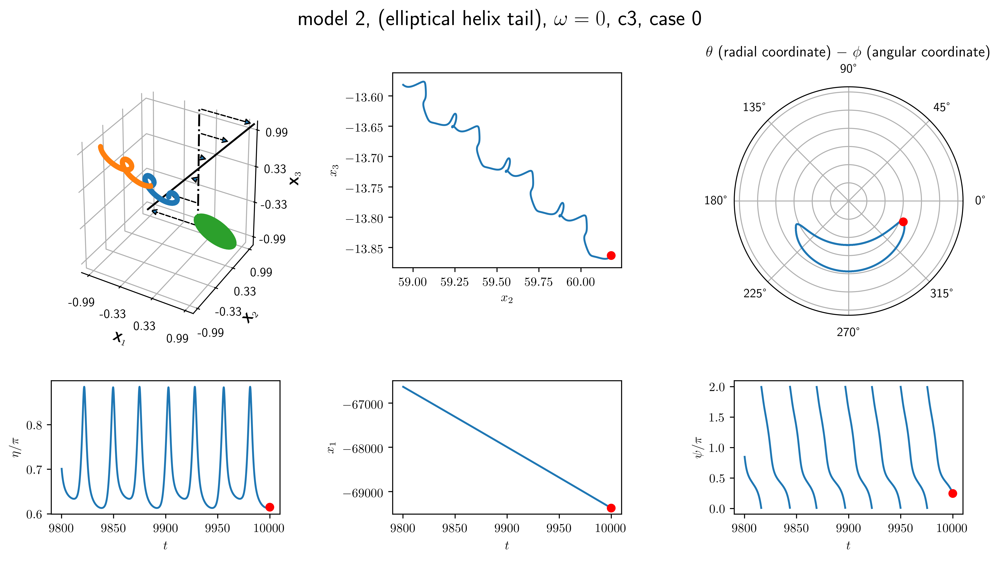

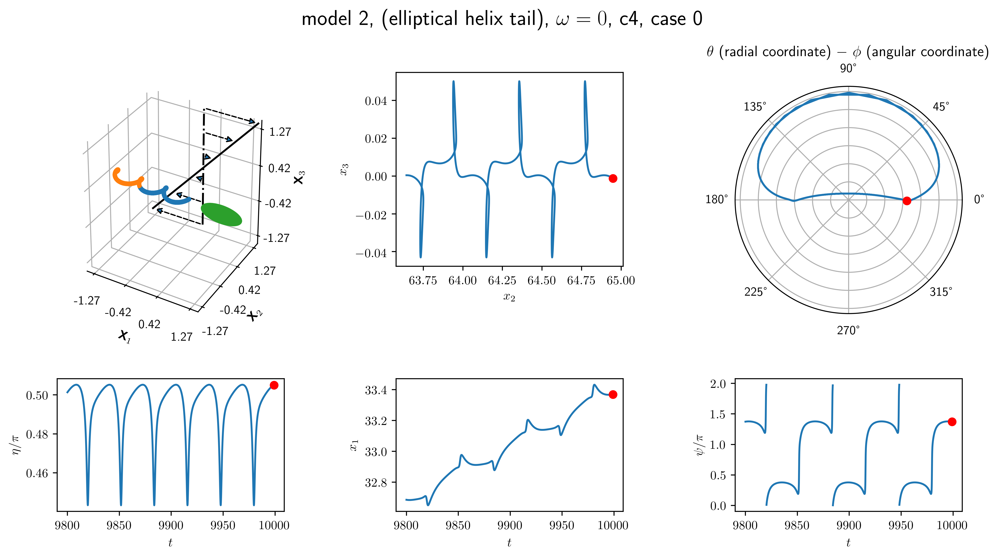

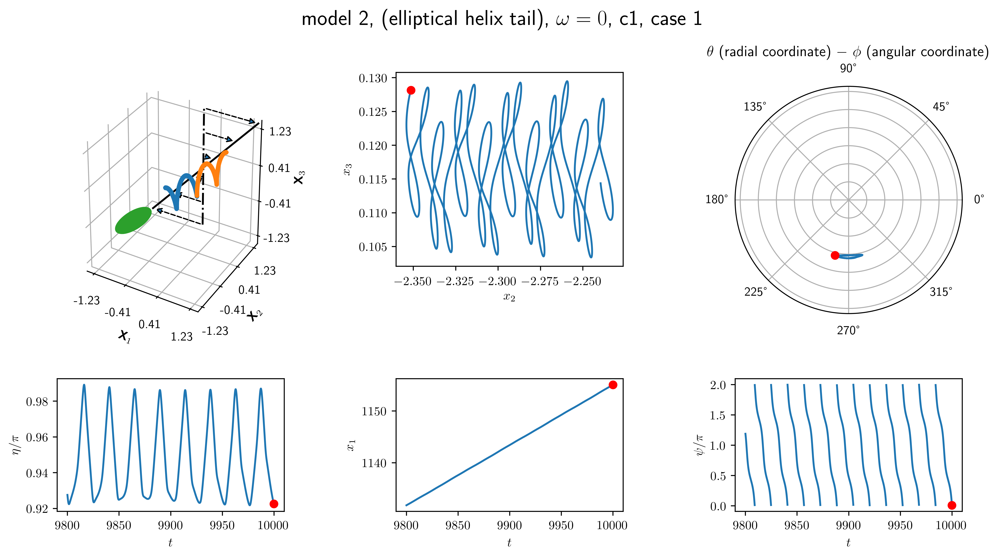

...

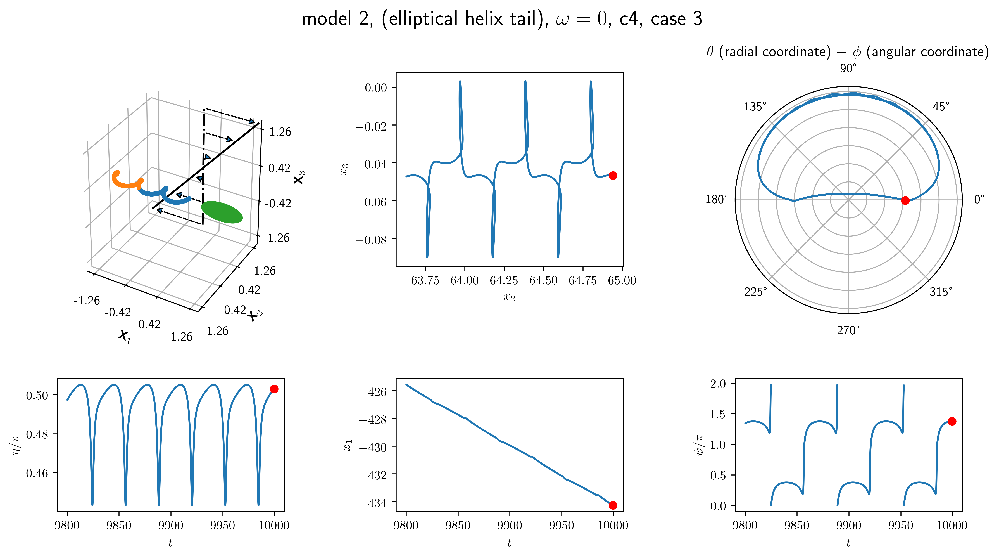

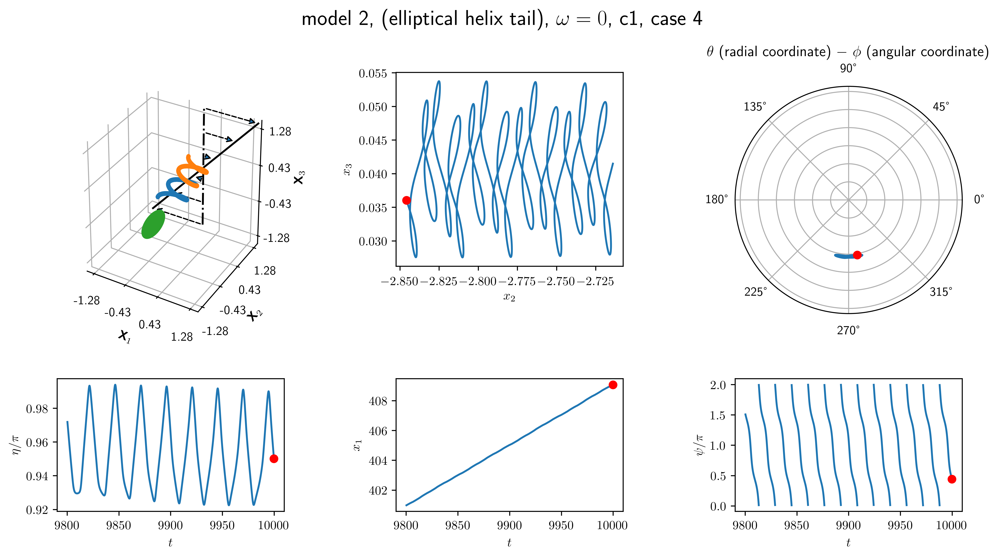

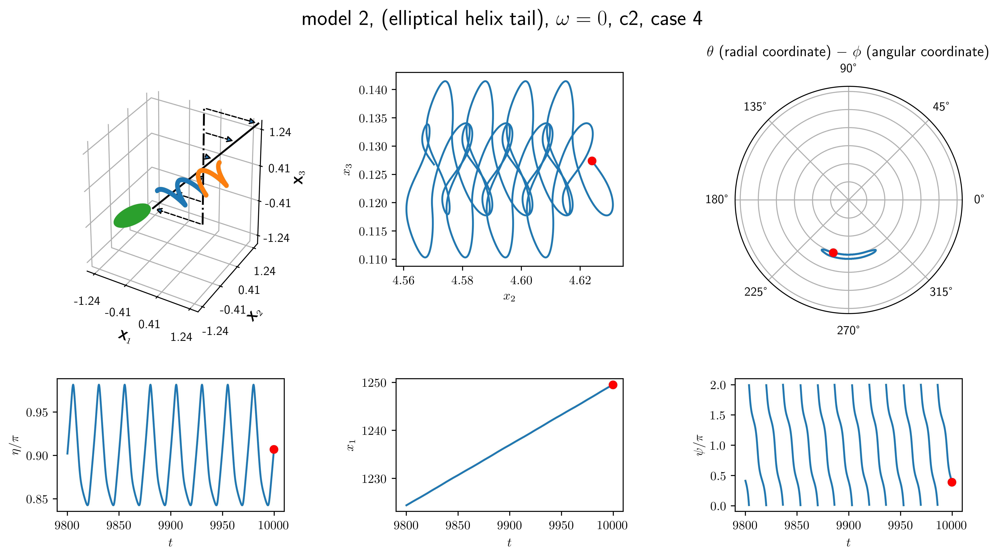

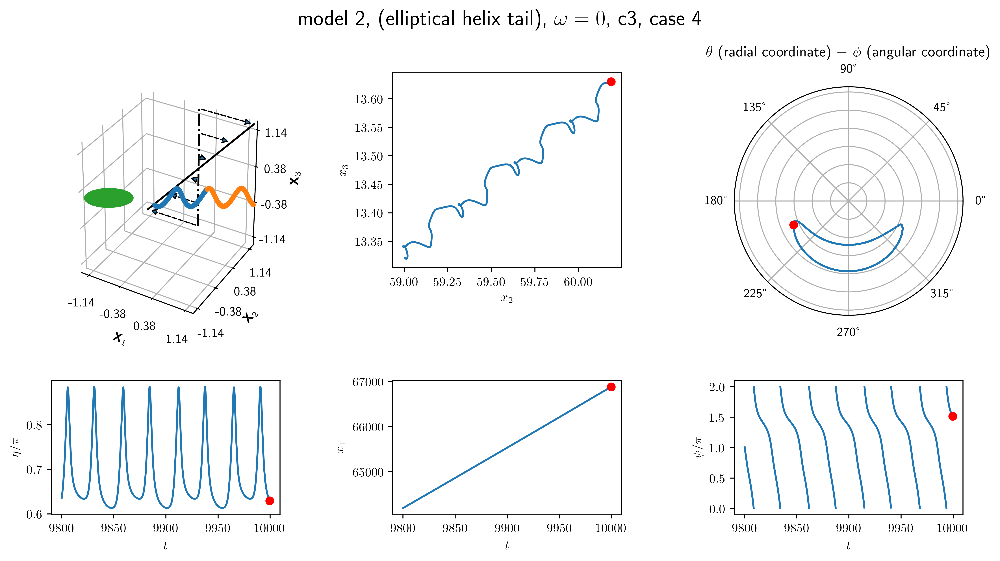

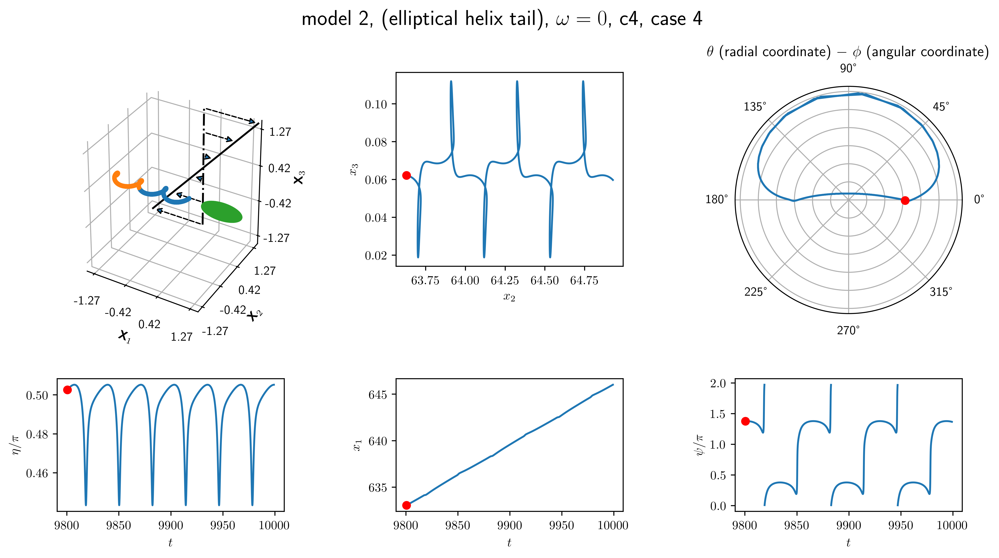

In [6]:
from shutil import copyfile
from src.objComposite import *

dbg_mode = False
# dbg_mode = 2
figsize=np.array((16, 9))*0.7
dpi = 500
tmin = 9800

title_handle = 'model 2, (elliptical helix tail), $\\omega=0$'
# case_info_list = [('c4', np.logical_or(np.logical_or(np.isclose(case_idx, 0),np.isclose(case_idx, 1)),
#                                 np.isclose(case_idx, 2))), 
#                   ('c3', np.isclose(case_idx, 3)), 
#                   ('c2', np.logical_and(np.isclose(case_idx, 5), dy_list > 0)), 
#                   ('c1', np.logical_and(np.isclose(case_idx, 5), dy_list < 0)), ]
case_info_list = [('c1', np.logical_and(np.isclose(case_idx, 5), dy_list < 0)), 
                  ('c2', np.logical_and(np.isclose(case_idx, 5), dy_list > 0)), 
                  ('c3', np.isclose(case_idx, 3)), 
                  ('c4', np.logical_or(np.logical_or(np.isclose(case_idx, 0), 
                                                     np.isclose(case_idx, 1)), 
                                       np.isclose(case_idx, 2))), ]
# trj_handle, tidx0 = 'c1', np.logical_and(np.isclose(case_idx, 5), dy_list < 0)
# trj_handle, tidx0 = 'c2', np.logical_and(np.isclose(case_idx, 5), dy_list > 0)

for i0 in range(5): 
    for trj_handle, tidx0 in case_info_list:
        suptitle = '%s, %s, case %2d' % (title_handle, trj_handle, i0)
        tpath = pickle_path_list[tidx0][i0]
        print(tpath)
        with open(tpath, 'rb') as handle:
            tpick = pickle.load(handle)
        Table_t = tpick['Table_t']
        Table_dt = tpick['Table_dt']
        Table_X = tpick['Table_X']
        Table_P = tpick['Table_P']
        Table_P2 = tpick['Table_P2']
        Table_theta = tpick['Table_theta']
        Table_phi = tpick['Table_phi']
        Table_psi = tpick['Table_psi']
        Table_eta = tpick['Table_eta']
        table_path = os.path.join('/home/zhangji/stokes_flow_master/src', 
                                  '%s.pickle' % tpick['problem_kwargs']['table_name'])
        with open(table_path, 'rb') as handle:
            table_path = pickle.load(handle)
        problem_kwargs = table_path['problem_kwargs']

        tidx = Table_t > tmin
        anim = spf_tb.make_table_video_geo_v2(Table_t[tidx], Table_X[tidx], Table_P[tidx], Table_P2[tidx],
                                      Table_theta[tidx], Table_phi[tidx], Table_psi[tidx], Table_eta[tidx],
                                      stp=1, interval=20, trange_geo=None, trange_trj=None, 
                                      create_obj_at_fun=get_ecoli_nodes_split_at, resampling_fct=5, 
                                      dbg_mode=dbg_mode, figsize=figsize, dpi=dpi, 
                                      suptitle=suptitle, **problem_kwargs)
        tname0 = '%s_%s_%02d' % (job_dir, trj_handle, i0)
        tname = os.path.join(os.getcwd(), 'MOVIE', '%s.pickle' % tname0)
        copyfile(tpath, tname)
        tname = os.path.join(os.getcwd(), 'MOVIE', '%s.mp4' % tname0)
        anim.save(tname, writer='ffmpeg', fps=30)
        print(datetime.now(), 'save to %s' % tname)
        print()

In [6]:
from shutil import copyfile

title_handle = 'model 2, (elliptical helix tail), $\\omega=0$'
case_info_list = [('c1', np.logical_and(np.isclose(case_idx, 5), dy_list < 0)), 
                  ('c2', np.logical_and(np.isclose(case_idx, 5), dy_list > 0)), 
                  ('c3', np.isclose(case_idx, 3)), 
                  ('c4', np.logical_or(np.logical_or(np.isclose(case_idx, 0), 
                                                     np.isclose(case_idx, 1)), 
                                       np.isclose(case_idx, 2))), ]

for trj_handle, tidx0 in case_info_list:
    for i0 in range(5): 
        suptitle = '%s, %s, case %2d' % (title_handle, trj_handle, i0)
        tpath = pickle_path_list[tidx0][i0]
#         print(tpath)
        tname0 = '%s_%s_%02d' % (job_dir, trj_handle, i0)
        tname = os.path.join(os.getcwd(), 'orintation', '%s.pickle' % tname0)
        copyfile(tpath, tname)
        tname = os.path.join(os.getcwd(), 'orintation', '%s.mat' % tname0)
        with open(tpath, 'rb') as handle:
            tpick = pickle.load(handle)
            savemat(tname, mdict={'tpick': tpick})
        print('save to %s' % tname)

save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c1_00.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c1_01.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c1_02.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c1_03.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c1_04.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c2_00.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c2_01.mat
save to /home/zhangji/stokes_flow_master/head_Force/do_calculate_table/orintation/ecoC01B05_passive_psi_rada_c2_02.mat
save to /home/zhangji/stokes_flow_master/head_Fo